In [12]:
import pandas as pd
import numpy as np
import plotly.express as px

In [13]:
df = pd.read_csv(r"C:\Users\Shalini\Downloads\term 2\DEVP 2\dev 2 project\customer_shopping_data.csv")

In [14]:
df.head()   
df = df.drop('Unnamed: 10', axis=1)

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99457 entries, 0 to 99456
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   invoice_no      99457 non-null  object 
 1   customer_id     99457 non-null  object 
 2   gender          99457 non-null  object 
 3   age             99457 non-null  int64  
 4   category        99457 non-null  object 
 5   quantity        99457 non-null  int64  
 6   price           99457 non-null  float64
 7   payment_method  99457 non-null  object 
 8   invoice_date    99457 non-null  object 
 9   shopping_mall   99457 non-null  object 
dtypes: float64(1), int64(2), object(7)
memory usage: 7.6+ MB


In [16]:
df.head()

,invoice_no,customer_id,gender,age,category,quantity,price,payment_method,invoice_date,shopping_mall
0,I138884,C241288,Female,28,Clothing,5,1500.40,Credit Card,5/8/2022,Kanyon
1,I317333,C111565,Male,21,Shoes,3,1800.51,Debit Card,12/12/2021,Forum Istanbul
2,I127801,C266599,Male,20,Clothing,1,300.08,Cash,9/11/2021,Metrocity
3,I173702,C988172,Female,66,Shoes,5,3000.85,Credit Card,16/05/2021,Metropol AVM
4,I337046,C189076,Female,53,Books,4,60.60,Cash,24/10/2021,Kanyon


In [17]:
print(df.columns)

Index(['invoice_no', 'customer_id', 'gender', 'age', 'category', 'quantity',
       'price', 'payment_method', 'invoice_date', 'shopping_mall'],
      dtype='object')


In [18]:
df['price'].max()

5250.0

In [19]:
import os

# Get the current working directory
current_directory = os.getcwd()

# Print the current working directory
print("Current Working Directory:", current_directory)

Current Working Directory: C:\Users\Shalini


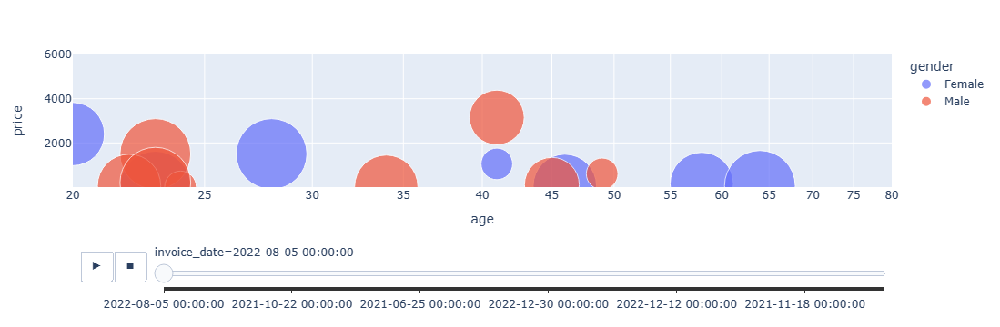

In [20]:
 df['invoice_date'] = pd.to_datetime(df['invoice_date'], format="%d/%m/%Y")
px.scatter(df, x="age", y="price", animation_frame="invoice_date", animation_group="category",
           size="quantity", color="gender", hover_name="category",
           log_x=True, size_max=55, range_x=[20, 80], range_y=[1, 6000])


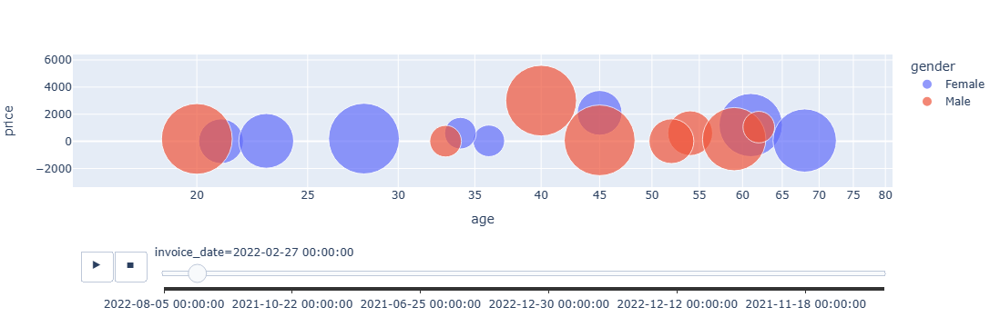

In [21]:
from IPython.display import Image

# Specify the path to the image
img_path =  (r"C:\Users\Shalini\Downloads\newplot.png")

# Display the image
Image(filename=img_path)

In [22]:
!pip install bar_chart_race
import bar_chart_race as bcr
import pandas as pd

In [23]:
df['quantity'].unique()

array([5, 3, 1, 4, 2], dtype=int64)

In [24]:
import bar_chart_race as bcr
import matplotlib.pyplot as plt
import matplotlib

In [25]:
matplotlib.rcParams['animation.embed_limit'] = 2**128

In [27]:
import pandas as pd
import bar_chart_race as bcr
import matplotlib.pyplot as plt
import matplotlib

wide_data = df.pivot_table(index='shopping_mall', columns='quantity', aggfunc='count', fill_value=0).cumsum()

In [28]:
wide_data.head()

age                         category                    \
quantity              1     2     3     4     5        1     2     3     4   
shopping_mall                                                                
Cevahir AVM        1022   959  1036   969  1005     1022   959  1036   969   
Emaar Square Mall  1954  1922  2027  1924  1975     1954  1922  2027  1924   
Forum Istanbul     2954  2897  3019  2898  2981     2954  2897  3019  2898   
Istinye Park       4878  4873  4944  4864  4971     4878  4873  4944  4864   
Kanyon             8892  8765  8962  8754  8980     8892  8765  8962  8754   

                         ... payment_method                         price  \
quantity              5  ...              1     2     3     4     5     1   
shopping_mall            ...                                                
Cevahir AVM        1005  ...           1022   959  1036   969  1005  1022   
Emaar Square Mall  1975  ...           1954  1922  2027  1924  1975  1954   
Forum Istanbul     2981  ...           2954  2897  3019  2898  2981  2954   
Istinye Park       4971  ...           4878  4873  4944  4864  4971  4878   
Kanyon             8980  ...           8892  8765  8962  8754  8980  8892   

                                           
quantity              2     3     4     5  
shopping_mall                              
Cevahir AVM         959  1036   969  1005  
Emaar Square Mall  1922  2027  1924  1975  
Forum Istanbul     2897  3019  2898  2981  
Istinye Park       4873  4944  4864  4971  
Kanyon             8765  8962  8754  8980  

[5 rows x 40 columns]

In [29]:
wide_data.columns = wide_data.columns.droplevel(0)

In [30]:
wide_data = wide_data.loc[:,~wide_data.columns.duplicated()] 

In [31]:
wide_data.head()

quantity,1,2,3,4,5
shopping_mall,,,,,
Cevahir AVM,1022,959,1036,969,1005
Emaar Square Mall,1954,1922,2027,1924,1975
Forum Istanbul,2954,2897,3019,2898,2981
Istinye Park,4878,4873,4944,4864,4971
Kanyon,8892,8765,8962,8754,8980


In [32]:
bcr.bar_chart_race(wide_data, filename='top_quantities.mp4')
#chart_html = bcr.bar_chart_race(wide_data, filename='topmalls.mp4')
# Display the HTML in the Jupyter Notebook
#chart_html

C:\Users\Shalini\anaconda3\Lib\site-packages\bar_chart_race\_make_chart.py:889: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\Shalini\anaconda3\Lib\site-packages\bar_chart_race\_make_chart.py:286: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\Shalini\anaconda3\Lib\site-packages\bar_chart_race\_make_chart.py:287: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



In [34]:
from IPython.display import Video

# Display the video in the Jupyter Notebook
Video("top_quantities.mp4")

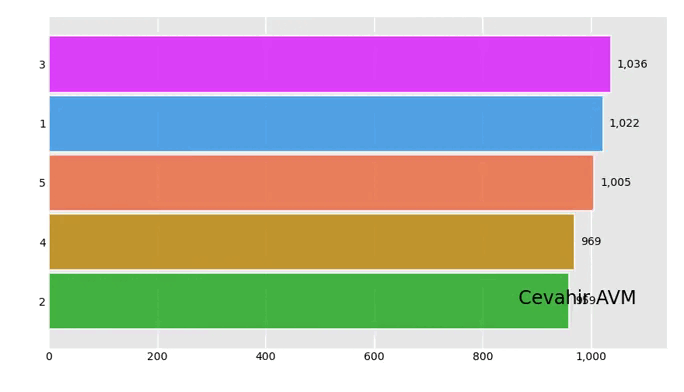

In [36]:
from IPython.display import Image

# Specify the path to the GIF
gif_path = (r"C:\Users\Shalini\top_quantities.gif")

# Display the GIF
Image(filename=gif_path)

In [22]:
import pandas as pd

# Assuming your DataFrame is named df
wide_data1 = df.pivot_table(index='shopping_mall', columns='category', values='price', aggfunc='sum', fill_value=0).cumsum()

# Display the resulting pivot table
wide_data1.head()

category,Books,Clothing,Cosmetics,Food & Beverage,Shoes,Souvenir,Technology,Toys
shopping_mall,,,,,,,,
Cevahir AVM,11998.80,1554414.40,88394.84,11992.39,884050.41,8304.84,819000.0,55516.16
Emaar Square Mall,23058.30,3066217.44,180774.36,23022.46,1755497.25,16820.82,1653750.0,104939.52
Forum Istanbul,34511.70,4638336.56,276000.08,33859.02,2631145.28,25911.57,2360400.0,159989.76
Istinye Park,55236.90,7688649.76,454741.44,57278.96,4437656.98,44280.75,3870300.0,269086.72
Kanyon,100217.25,13844190.80,826983.74,102753.81,8077688.03,79764.00,7072800.0,483589.12


In [23]:
bcr.bar_chart_race(wide_data1, filename='top_categories_by_price.mp4')

C:\Users\Shalini\anaconda3\Lib\site-packages\bar_chart_race\_make_chart.py:889: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\Shalini\anaconda3\Lib\site-packages\bar_chart_race\_make_chart.py:286: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\Shalini\anaconda3\Lib\site-packages\bar_chart_race\_make_chart.py:287: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



In [29]:
from IPython.display import Video

# Display the video in the Jupyter Notebook
Video("top_categories_by_price.mp4")

In [25]:
df['invoice_date'] = pd.to_datetime(df['invoice_date'], format="%d/%m/%Y")

# Sort the DataFrame by 'invoice_date'
df = df.sort_values(by='invoice_date')
wide_data2 = df.pivot_table(index='invoice_date', columns='shopping_mall', values='price', aggfunc='sum', fill_value=0).cumsum()
wide_data2.head()

shopping_mall,Cevahir AVM,Emaar Square Mall,Forum Istanbul,Istinye Park,Kanyon,Mall of Istanbul,Metrocity,Metropol AVM,Viaport Outlet,Zorlu Center
invoice_date,,,,,,,,,,
2021-01-01,1071.02,5516.83,2207.52,6379.84,13833.99,21000.22,12911.89,2995.89,77.03,5530.65
2021-01-02,3418.69,7512.22,6596.89,16974.01,29833.68,49021.29,22841.82,9090.64,1857.30,9636.24
2021-01-03,10210.18,9720.30,11905.62,19752.40,51082.22,73116.78,46618.66,16690.79,6140.92,14437.56
2021-01-04,14076.48,13123.67,16238.49,19957.91,70931.98,92839.02,51462.79,24219.43,10714.90,21535.84
2021-01-05,16742.43,15046.16,22803.04,32250.68,85922.70,121716.80,62109.02,29738.15,12922.98,21703.71


In [27]:
bcr.bar_chart_race(wide_data2, filename='top_malls_by_price.mp4')

C:\Users\Shalini\anaconda3\Lib\site-packages\bar_chart_race\_make_chart.py:889: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\Shalini\anaconda3\Lib\site-packages\bar_chart_race\_make_chart.py:286: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\Shalini\anaconda3\Lib\site-packages\bar_chart_race\_make_chart.py:287: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



In [28]:
from IPython.display import Video

# Display the video in the Jupyter Notebook
Video("top_malls_by_price.mp4")